In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from pandas import DataFrame

import re
import string
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer
from nltk.tokenize import sent_tokenize, word_tokenize
# nltk.download('wordnet')
# nltk.download('omw-1.4')


from PIL import Image
import matplotlib.pyplot as plt
from wordcloud import STOPWORDS, WordCloud
import seaborn as sns


from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_validate
from sklearn.pipeline import make_pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

import googletrans
from googletrans import Translator

In [8]:
indie_df = pd.read_csv('artist_list.csv')
indie_id_list = list(indie_df['code'])
indie_id_list = list(set(indie_id_list))

138

In [31]:
df_list = []
for i in indie_id_list:
    df_list.append(pd.read_csv(f'./data/merged/{i}_merged.csv'))

In [32]:
all_df = pd.concat(df_list)
all_df['date'] = pd.to_datetime(all_df['date'])
all_df['year'] = pd.DatetimeIndex(all_df['date']).year

In [13]:
all_df.to_csv('data/indie_final_dataframe')

In [33]:
#whole dataframe
def get_data(artist_id_input):
    total_df = pd.read_csv('data/indie_final_dataframe')
    df = total_df[total_df['artist_id']==int(artist_id_input)][['artist_x', 'song_name', 'year', 'Lyric']]
    return df

def clean_text(text):

        manual_sw = []

        #changing to lowercase
        text = text.lower()
        text = text.replace('\r',' ')

        # removing #´s 
        text = re.sub(r'#[A-Za-z0-9]+', ' ', text)
        text = re.sub(r'#', ' ', text)

        #indentation -> space
        text = re.sub(r'\n', ' ', text)

        for punctuation in string.punctuation:
            text = text.replace(punctuation, '') 

        #strip
        text = text.strip()

        #tokenization
        tokens = word_tokenize(text)   
        filtered_words = [w for w in tokens if w not in manual_sw]
        final = " ".join(cat for cat in filtered_words)

        return final



def basic_cleaning(artist_id):
    
    df = get_data(artist_id)
    df['final_lyrics'] = df['Lyric'].apply(clean_text)
    df = df.groupby(['year']).sum()[['final_lyrics']]

    return df

    

In [ ]:
for i in indie_id_list:
    get_data(i)

# Wordcloud

In [43]:
def simple_wordcloud_2(total):
    
    wordcloud = WordCloud(font_path = 'LINESeedKR-Rg.otf', width = 1000, height = 500, colormap='RdPu_r', 
                        max_words=150, background_color= 'white', collocations = False).generate(total)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()
    
#     wordcloud.to_file(f"final_wordcloud_png/{artist_id}_wordcloud.png")
    

In [34]:
def simple_wordcloud(artist_id):
    df = basic_cleaning(artist_id)
    
    total_lyrics = " ".join(cat for cat in df.final_lyrics)
    
    wordcloud = WordCloud(font_path = 'LINESeedKR-Rg.otf', width = 1000, height = 500, colormap='RdPu_r', 
                        max_words=70, background_color= 'white', collocations = False).generate(total_lyrics)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()
    
#     wordcloud.to_file(f"final_wordcloud_png/{artist_id}_wordcloud.png")
    

In [35]:
def wordcloud_by_year(artist_id):
    
    df = basic_cleaning(artist_id)
    
    def by_year(df):
        lyrics_of_years = []
        for i in range(len(df)):
            one_year = " ".join(cat for cat in df.iloc[i, :])
            lyrics_of_years.append(one_year)
        return lyrics_of_years


    lyric_lst = by_year(df)
    year_lst = [i for i in df.index]
    
    for lyric in lyric_lst:
        word_cloud = WordCloud(font_path='Binggrae', width = 1000, height = 500, 
        colormap='BuPu', max_words=100, collocations = False).generate(lyric)

        plt.figure(figsize = (10,8))
        plt.imshow(word_cloud, interpolation='bilinear')
        plt.axis("off")
        plt.title(year_lst[lyric_lst.index(lyric)])
        plt.show()
        
        

In [ ]:
wordcloud_by_year

## total wordcloud

In [36]:
indie_total_df = pd.read_csv('data/indie_final_dataframe')
indie_total_df = indie_total_df[['artist_x', 'artist_id', 'song_name', 'year', 'Lyric']]
indie_total_df['final_lyrics'] = indie_total_df.Lyric.apply(clean_trans)
indie_total_df.drop(columns = ['Lyric'], inplace = True)
indie_total_df

,artist_x,artist_id,song_name,year,final_lyrics
0,굴소년단,80023059,이유없이,2010,주저하고 있었네 집으로 가는 길에 멍하니 유치한 대사처럼 어디로도 가고 싶지 않았네...
1,굴소년단,80023059,니가 뭔데,2010,어차피 올거라면 빨리 오지 뭔데 뜸을 들여 전화를 해보아도 받지 않고 왜 속을 썩여...
2,굴소년단,80023059,참치,2010,참치 김밥을 자주 먹는데 따라 참치가 배속에서 춤을 추네 모든 바다에서 시작되었고 ...
3,굴소년단,80023059,세미스타,2010,당신의 이야기 눈빛 미소 짓는 모습은 언제나 거기에 있을 기분 유어 뮤직 유어 기타...
4,굴소년단,80023059,미소 짓는 사람,2010,검은 눈동자 어깨 위로 내려 앉은 머리결 어떤 이유도 설명도 필요 없는 마치 그런 ...
...,...,...,...,...,...
8546,Dept(뎁트),20020910,"Who Are You (Feat. J.O.Y, GARETH FERNANDEZ)",2022,who 그대는 누구인가요 dont think time 아직은 we가 ever say...
8547,Dept(뎁트),20020910,"Ocean View (Feat. Kelsey Kuan, prettyhappy)",2022,been too long since have left my room inside w...
8548,Dept(뎁트),20020910,Selfish Love (Feat. Ashley Alisha),2022,dont need your selfish love 필요 없어 그대의 이기적인 lov...
8549,Dept(뎁트),20020910,As It Is (Feat. Ashley Alisha),2022,sometimes think of what we 가끔 we가 서로에게 무엇인지 생각...


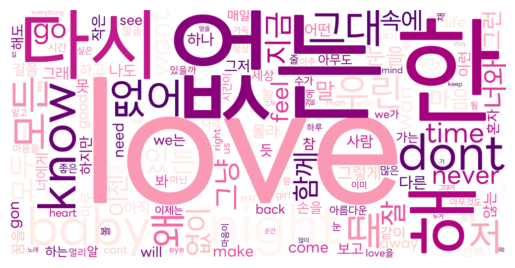

In [44]:
simple_wordcloud_2(total_lyrics)

In [38]:
total_lyrics = " ".join(cat for cat in indie_total_df.final_lyrics)
total_lyrics

'주저하고 있었네 집으로 가는 길에 멍하니 유치한 대사처럼 어디로도 가고 싶지 않았네 어디로도 가고 싶지 않았네 굿 나잇 버트 바카락처럼 쓸쓸한 해피 엔딩으로 오늘을 보낸다 이런 기분에 걷다가 철없는 삼십대인 듯 하여 잠시 부끄러워지다가 나도 모르게 왠지 기분이 들떠서 가벼운 마음에 집으로 걸으며 굿 나잇 버트 바카락처럼 쓸쓸한 해피 엔딩으로 오늘을 보낸다 굿 나잇 굿 나잇 일들을 당연한듯이 너에게 떠들어대겠지 어차피 올거라면 빨리 오지 뭔데 뜸을 들여 전화를 해보아도 받지 않고 왜 속을 썩여 뭔데 뭔데 자꾸만 생각나도 이번에는 용서하지 않을 그러니 올거라면 빨리 오지 왜 뜸을 들여 이번에는 용기를 낼 꺼야 뭔데 속을 썩여 생각에 속이 썩어 참치 김밥을 자주 먹는데 따라 참치가 배속에서 춤을 추네 모든 바다에서 시작되었고 참치는 바다로 가려 하네 데려가려고 하네 참치는 바다로 가려고 하네 데리고 가려고 하네 그래 바다 거기서 숨통을 틔어야지 당신의 이야기 눈빛 미소 짓는 모습은 언제나 거기에 있을 기분 유어 뮤직 유어 기타 당신의 목소리가 들릴 것만 오늘night 언제나 거기에 있을 사람 커저 뮤직 플레이 포레버 플레이스 포레버 당신의 이야기 손짓 함께했던 순간은 언제나 거기에 있을 기분 검은 눈동자 어깨 위로 내려 앉은 머리결 어떤 이유도 설명도 필요 없는 마치 그런 이야기여야 하는 night을 달려 만나는 너와의 세상 마치 그런 너와나 아무런 말도 못하고 수줍게 바라만 보다가 새벽쯤의 길 위에 마음에다 주술을 걸어 미소를 건넨다 검은 눈동자 어깨 위로 내려 앉은 머리결 어떤 이유도 설명도 필요 없는 거리 위에 너와나 새벽쯤에 길 위에 마음에다 주술을 걸어 미소를 건넨다 우린 기억하지 시청 앞에서 we가 밝힌 촛불의 의미를 두손 가득한 위로도 닫힌 입술의 무언도 모두다 세상을 향한 눈물인걸 우린 기억하지 검게 그을린 지하철 역 안에 놓인 국화꽃의 의미를 말이 없는 사진 울고 있는 모두다 세상을 향한 눈물인걸 잊을 없는 눈물인걸 씻을 없는 눈물인걸 눈물인걸 우

In [ ]:
indie_total_lyrics = indie.drop(columns='year')
indie_total_lyrics = indie_2.groupby('artist_id').sum()[['final_lyrics']]

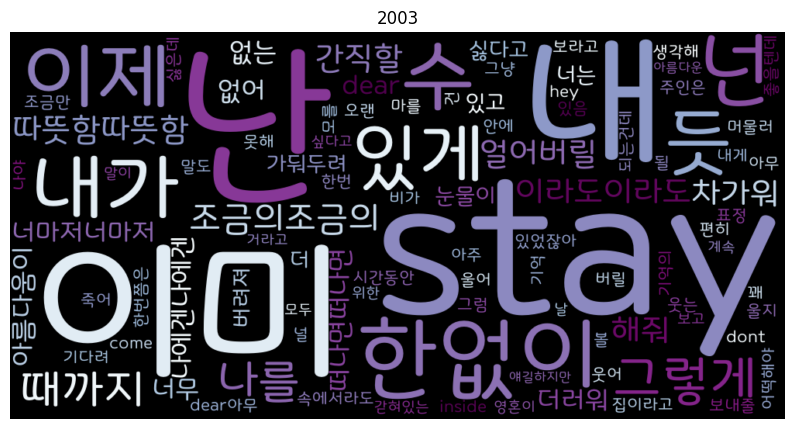

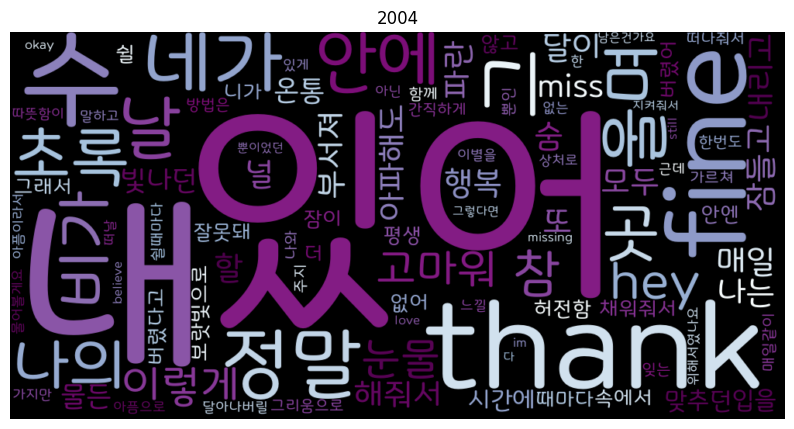

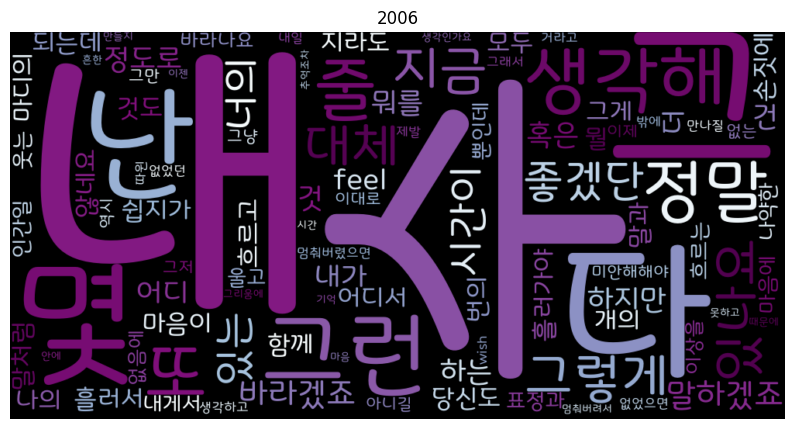

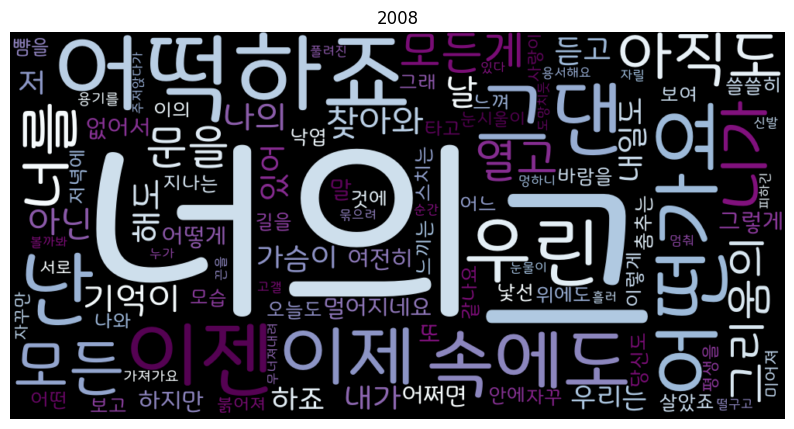

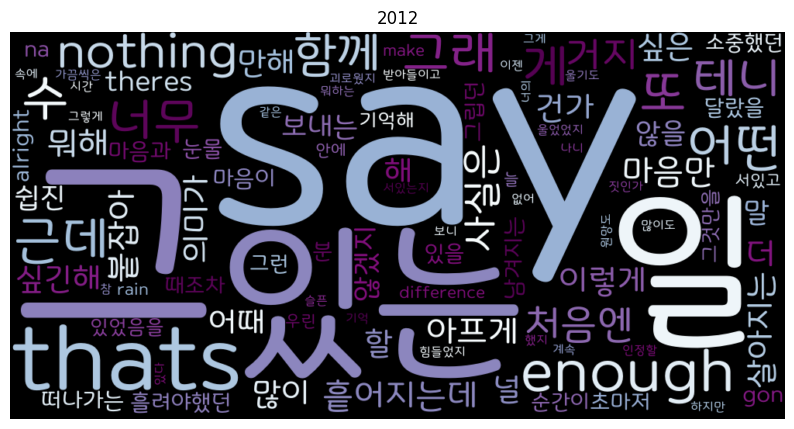

...

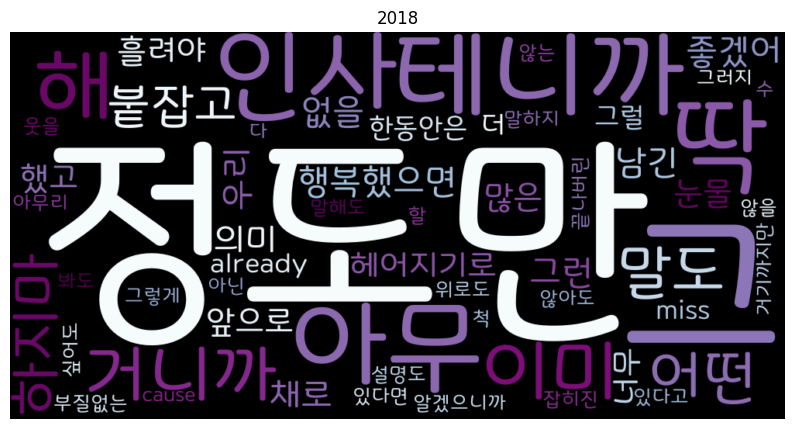

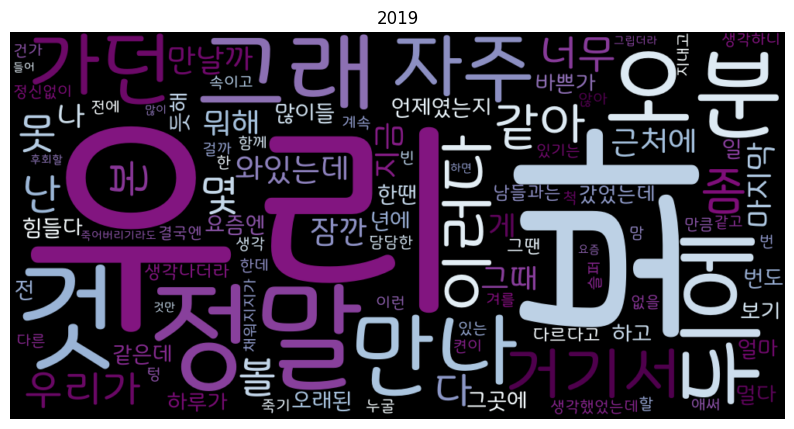

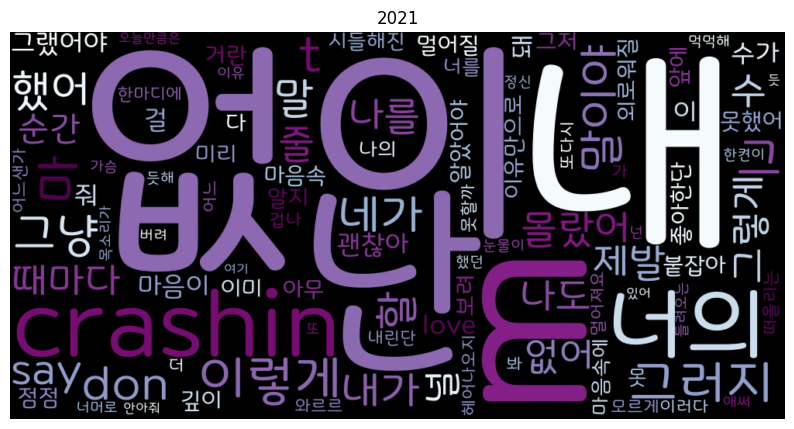

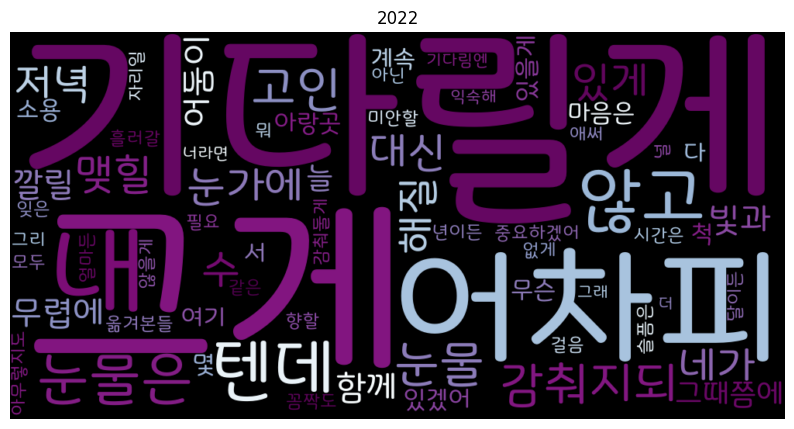

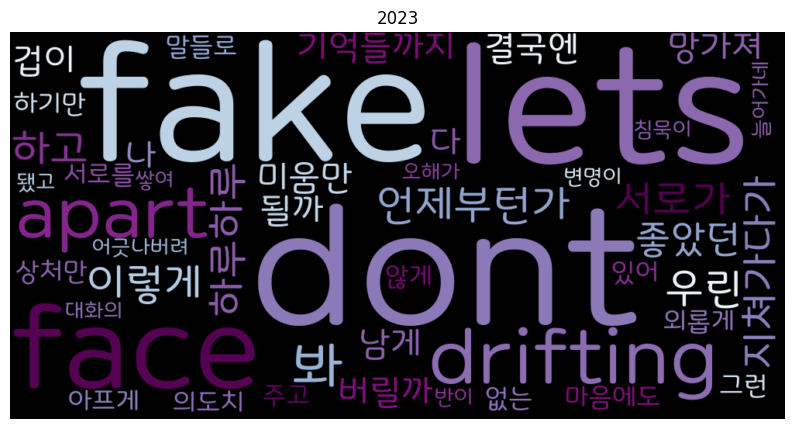

In [45]:
wordcloud_by_year(7536)

In [47]:
indie_total_df

,artist_x,artist_id,song_name,year,final_lyrics
0,굴소년단,80023059,이유없이,2010,주저하고 있었네 집으로 가는 길에 멍하니 유치한 대사처럼 어디로도 가고 싶지 않았네...
1,굴소년단,80023059,니가 뭔데,2010,어차피 올거라면 빨리 오지 뭔데 뜸을 들여 전화를 해보아도 받지 않고 왜 속을 썩여...
2,굴소년단,80023059,참치,2010,참치 김밥을 자주 먹는데 따라 참치가 배속에서 춤을 추네 모든 바다에서 시작되었고 ...
3,굴소년단,80023059,세미스타,2010,당신의 이야기 눈빛 미소 짓는 모습은 언제나 거기에 있을 기분 유어 뮤직 유어 기타...
4,굴소년단,80023059,미소 짓는 사람,2010,검은 눈동자 어깨 위로 내려 앉은 머리결 어떤 이유도 설명도 필요 없는 마치 그런 ...
...,...,...,...,...,...
8546,Dept(뎁트),20020910,"Who Are You (Feat. J.O.Y, GARETH FERNANDEZ)",2022,who 그대는 누구인가요 dont think time 아직은 we가 ever say...
8547,Dept(뎁트),20020910,"Ocean View (Feat. Kelsey Kuan, prettyhappy)",2022,been too long since have left my room inside w...
8548,Dept(뎁트),20020910,Selfish Love (Feat. Ashley Alisha),2022,dont need your selfish love 필요 없어 그대의 이기적인 lov...
8549,Dept(뎁트),20020910,As It Is (Feat. Ashley Alisha),2022,sometimes think of what we 가끔 we가 서로에게 무엇인지 생각...


In [60]:
indie_temp = indie_total_df[['year', 'final_lyrics']]
indie_by_year_df = indie_temp.groupby(['year']).sum()[['final_lyrics']]
indie_by_year_df.dropna(inplace=True)

In [63]:
indie_by_year_df = indie_by_year_df.loc[2008:]
indie_by_year_df

,final_lyrics
year,
2008,아직도 소리를 듣고 아직도 손길을 느껴 오늘도 흔적 안에 살았죠 아직도 모습이 보여...
2009,농담을 하곤 했지 집으로 가는 잠이든 좁은 길에 보며 웃으며 조그만 목소리로 말했지...
2010,주저하고 있었네 집으로 가는 길에 멍하니 유치한 대사처럼 어디로도 가고 싶지 않았네...
2011,어두워진 night이면 토요일의 night이면 chest은 뜨거워 상상조차 못할 가...
2012,처음엔 많이도 힘들었지 인정할 없어 괴로웠지 하지만 받아들이고 나니 이젠 그게 슬픈...
2013,지금까진 전부 잊어 조용히 눈을 감고 가둔 벽을 부숴 알고 있었던 모든게 아무것도 ...
2014,천천히 솔직히 아주 금방까진 아니더라도 언젠간 잊혀질 거라고 믿었지 그렇게 믿고 지...
2015,그리 오랜 시간이 필요하지도 않았지 가장 친한 친구를 잃었다는 깨닫기까지 어떤 누구...
2016,똑같은 하루가 지나갈 뿐 달라지는 아무것도 없겠지 언제나 그랬듯 짓궂은 기억은 다시...


In [51]:
def wc_by_year_2(df):
    def by_year(df):
        lyrics_of_years = []
        for i in range(len(df)):
            one_year = " ".join(cat for cat in df.iloc[i, :])
            lyrics_of_years.append(one_year)
        return lyrics_of_years


    lyric_lst = by_year(df)
    year_lst = [i for i in df.index]

    for lyric in lyric_lst:
        word_cloud = WordCloud(font_path='Binggrae', width = 1000, height = 500, 
        colormap='BuPu', max_words=100, collocations = False).generate(lyric)

        plt.figure(figsize = (10,8))
        plt.imshow(word_cloud, interpolation='bilinear')
        plt.axis("off")
        plt.title(year_lst[lyric_lst.index(lyric)])
        plt.show()

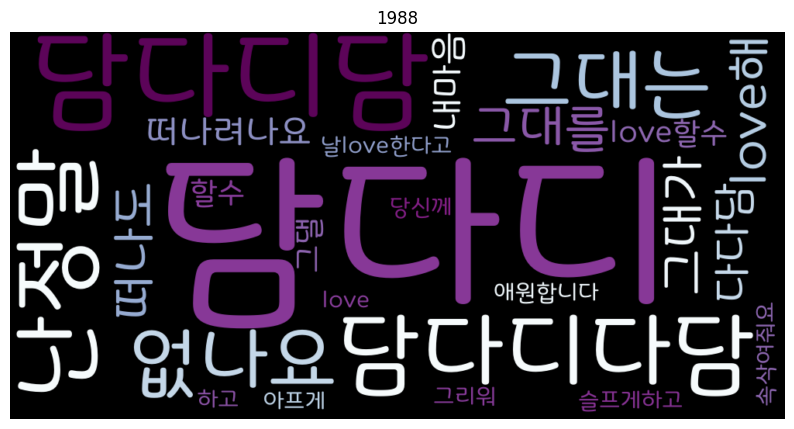

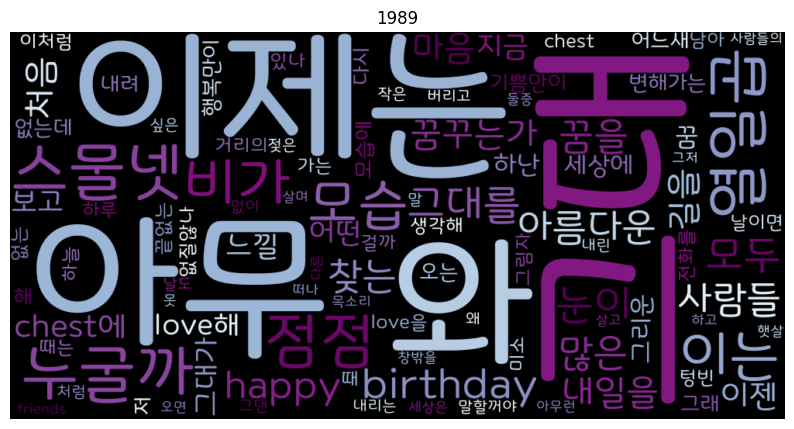

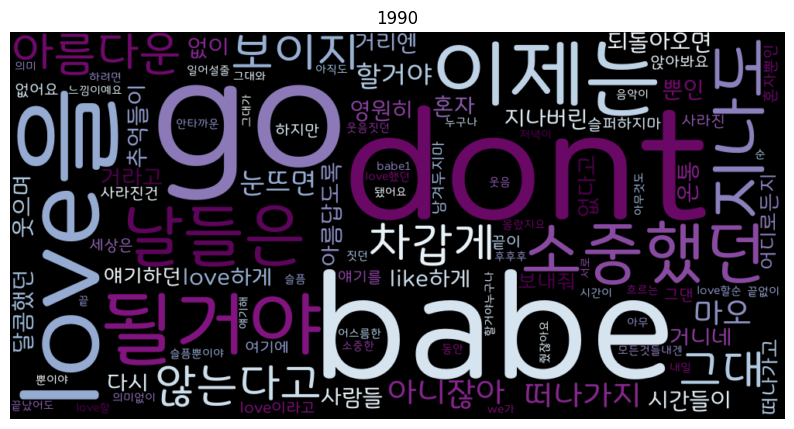

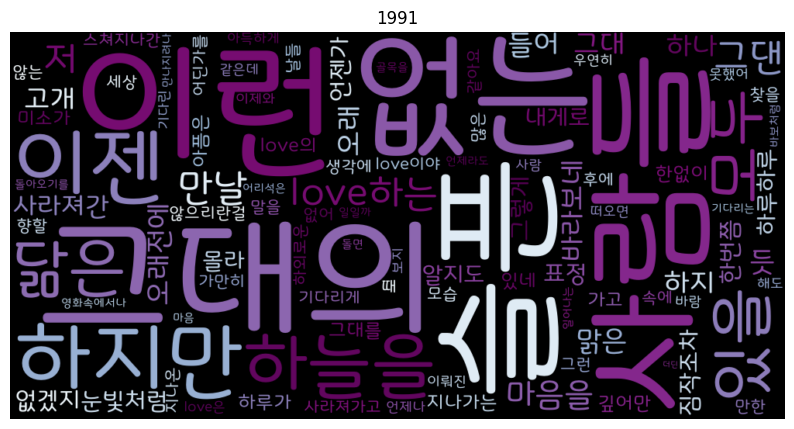

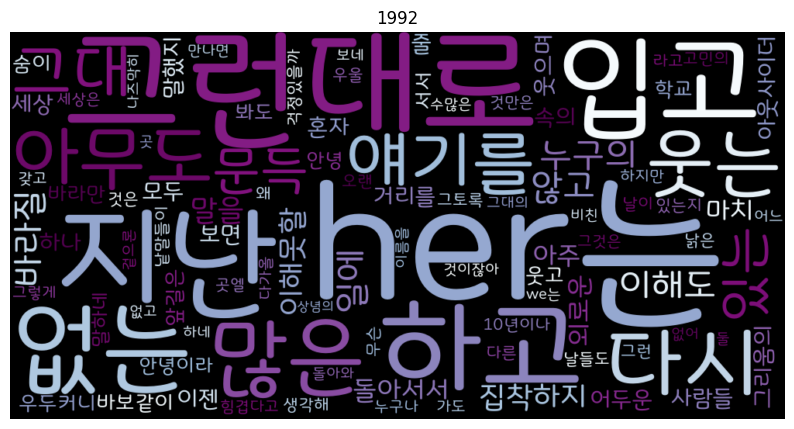

...

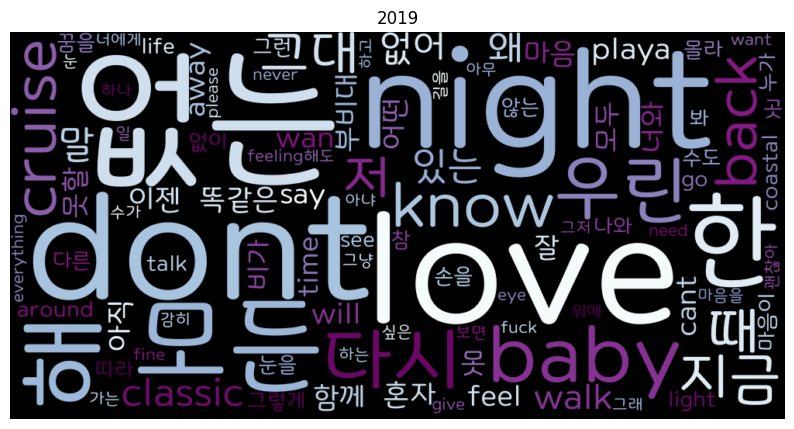

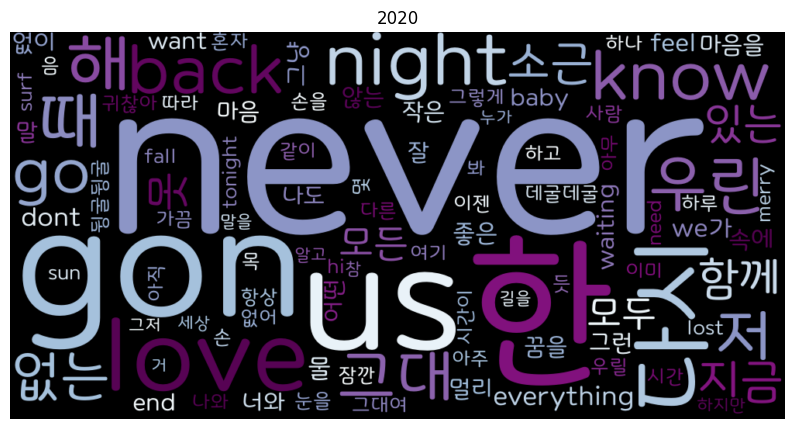

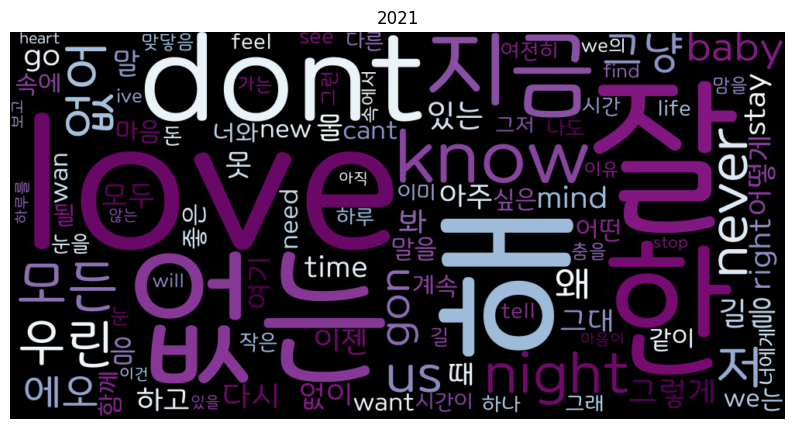

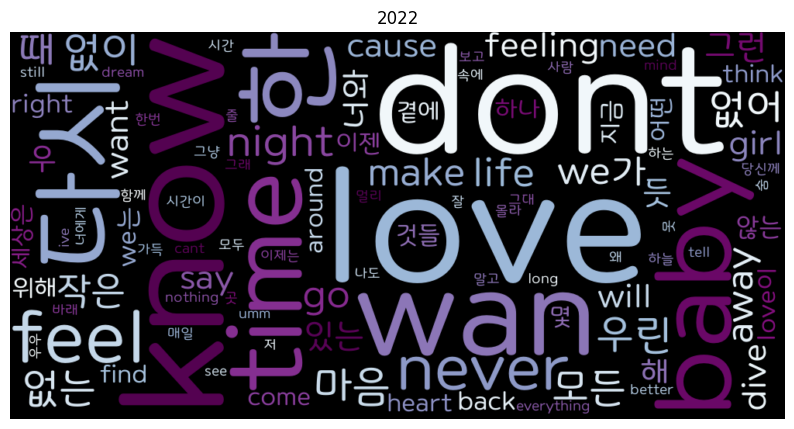

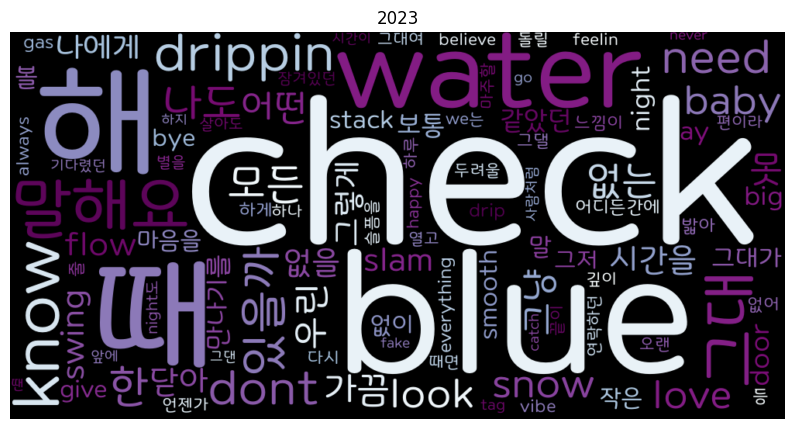

In [62]:
wc_by_year_2(indie_by_year_df)

In [ ]:
voc_lst=['cha','asunder','이젠','손을','그렇게','해도','baby','해','tickin','수가','하고','gon','go','say','때','것을','채','단','눈을','예','한','cream','christmas','merry','make','know','her의','we는','눈이','볼','바바바','너에게ohh','people','give','90s','wan','하고','대로','줄','잘','알','될','come','acdc','이런','raw','de','que','look''아아아','bye','있을','하는','저','그렇게','쿵','참','말아라','chest에','님아','red','오오','모십니다','maker','우','어떤','we가','waterfalls','tell','음악으로','풍문으로','build','don','talk','보여','say','blue','techno','shoes','와','누가','되어','가는','고개','gim','들어','가지','we는','doo','alway','것만','tell','bie','춤을','green','채팅','먹어','umm','대로','순간','know','그건','나와','cruise','coastal','classic','playa','light','하는','see','그래','eye','time','비가','sun','hi','sun','surf','ive','위에','달이','안엔','hey','지금','우','dive','cause','하나','see','know','에오','길을','맞닿음','보고','될','음','아주','이유','나도','몇','surf']